### Imports

In [2]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from PIL import Image
import cv2
import os
from os import listdir

from skimage import data
from skimage import transform
from scipy.ndimage import binary_fill_holes
from skimage import img_as_ubyte
from skimage.color import rgb2gray, rgb2hsv
from skimage.exposure import equalize_hist, histogram
from skimage.feature import canny
from skimage.filters import threshold_otsu, unsharp_mask, gaussian
from skimage.measure import find_contours, approximate_polygon
from skimage.morphology import (dilation, erosion, binary_closing, binary_opening,
                                remove_small_objects, thin, convex_hull_image, square, disk, diamond, star)
from skimage.segmentation import clear_border
from skimage.util import invert

In [3]:
from tqdm import tqdm

### Functions

In [4]:
def to_bin_uint8(img):
    return img.astype(np.uint8) * 255

In [5]:
def to_1ch(img, mode='gray'):
    transf_1ch = (
        {'r': lambda img: img[:, :, 0],
         'g': lambda img: img[:, :, 1],
         'b': lambda img: img[:, :, 2],
         'h': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 0]),
         's': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 1]),
         'v': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 2]),
         'gray': lambda img: img_as_ubyte(rgb2gray(img))}
    )
    return transf_1ch[mode](img)

In [6]:
def to_bin(img, thr='otsu'):
    if thr == 'otsu':
        return img > threshold_otsu(img)
    else:
        return img > 255 * thr

In [7]:
def list_get(list_, ind_, default_):
  try:
    return list_[ind_]
  except IndexError:
    return default_

In [8]:
def set_padding(img, num, val):
    if num > 0:
        h, w = img.shape
        new_img = np.full((h + 2 * num, w + 2 * num), val)
        new_img[num:-num, num:-num] = img
        img = new_img.astype(img.dtype)
    elif num < 0:
        num = -num
        img = img[num:-num, num:-num]
    return img

In [9]:
def resize_prop(img, max_size):
    h, w = img.shape[:2]
    img_max_size = max(w, h)
    if max_size < img_max_size:
        ratio = img_max_size / max_size
        w, h = int(w / ratio), int(h / ratio)
        
        img = cv2.resize(img, (w, h),
                         interpolation=cv2.INTER_AREA)
    return img

In [10]:
def show_images(img_arr, name_arr=[], n_in_row=3, factor_r=4, factor_c=4, figsize=None,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    if type(img_arr) is np.ndarray:
        quant = img_arr.shape[0]
    elif type(img_arr) is list:
        quant = len(img_arr)
    cols = min(quant, n_in_row)
    rows = quant // n_in_row + (1 if quant % n_in_row else 0)
    if figsize is None:
        figsize = (int(factor_c * cols), int(factor_r * rows))
    fig = plt.figure(figsize=figsize)
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    for i, img in enumerate(img_arr):
        ax = fig.add_subplot(rows, cols, i + 1)
        if type(img) is tuple:
            x, y = img
            ax.plot(x, y)
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
        else:
            ax.imshow(img, cmap=cmap_)
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
            ax.xaxis.set_major_locator(MaxNLocator(integer=True))
            ax.yaxis.set_major_locator(MaxNLocator(integer=True))
            ax.xaxis.set_ticks_position('top')
            ax.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    plt.show()

In [11]:
def show_image_cv(img, name):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    img = resize_prop(img, 700)
    cv2.imshow(name, img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

### Inputs

In [12]:
input_folder = 'src'
output_folder = 'out'
bg_folder = 'bg'
bg_names = listdir(bg_folder)
src_names_arr = listdir(input_folder)

In [13]:
bg_images = []
for name in tqdm(bg_names):
    bg_images.append(np.array(Image.open(f'{bg_folder}/{name}')))

100%|████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 12.70it/s]


In [14]:
src_images = []
for name in tqdm(src_names_arr):
    src_images.append(np.array(Image.open(f'{input_folder}/{name}')))

100%|██████████████████████████████████████████████████████████████████████████████████| 33/33 [00:06<00:00,  5.12it/s]


### Experiment 1: paper mask

In [15]:
modes = ['r', 'g', 'b', 'h', 's', 'v', 'gray']

In [16]:
img = src_images[0]
one_ch_list = [to_1ch(img, mode=mode) for mode in modes]

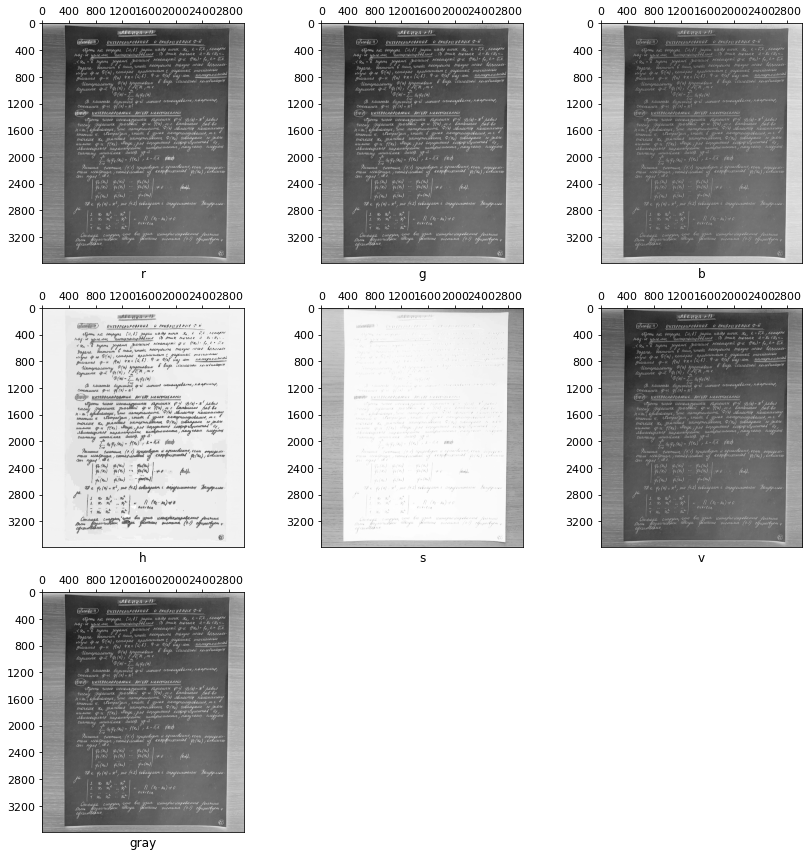

In [17]:
show_images(one_ch_list, modes)

In [18]:
def get_paper_mask(img, border=0):
    img = to_1ch(img, mode='s')
    img = to_bin(img)
    img = invert(img)
    
    pad_val = 30
    
    img = set_padding(img, pad_val, False)
    img = binary_fill_holes(img, disk(1))
    img = binary_closing(img, disk(10))
    if border > 0:
        img = erosion(img, disk(border))
    img = remove_small_objects(img, 10000)
    img = set_padding(img, -pad_val, False)

    img = to_bin_uint8(img)
    return img > 0

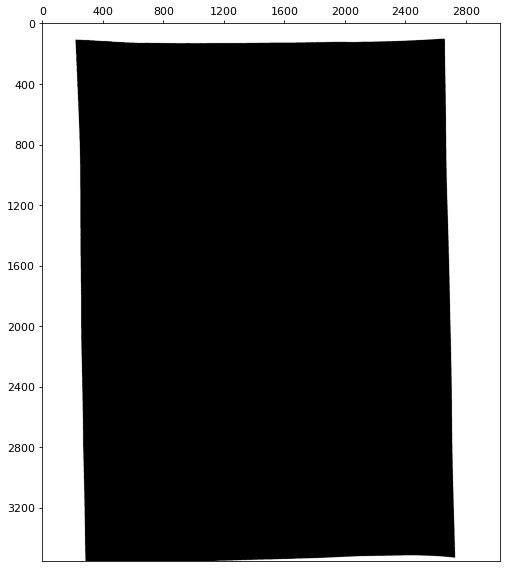

In [19]:
# idx: 6, 7, 8

img = src_images[6]
img = img

res_ = get_paper_mask(img)

show_images([res_], factor_r = 8, factor_c = 8) 

# show_image_cv(res, '')

### Experiment 2: text mask

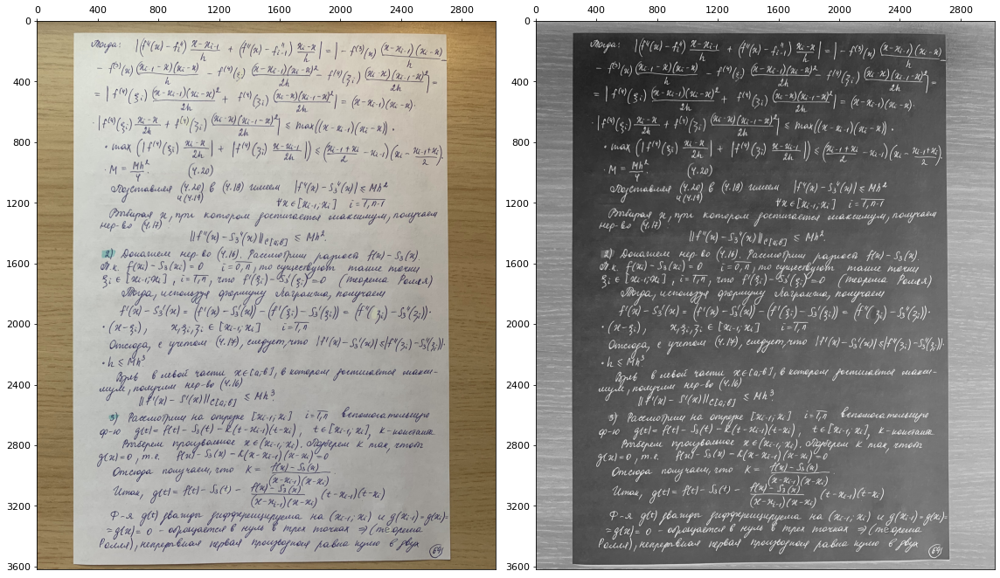

In [22]:
img = src_images[7]

img_src = img
img_1ch = to_1ch(img, 'gray')
show_images([img_src, img_1ch], factor_r = 10, factor_c = 8) 

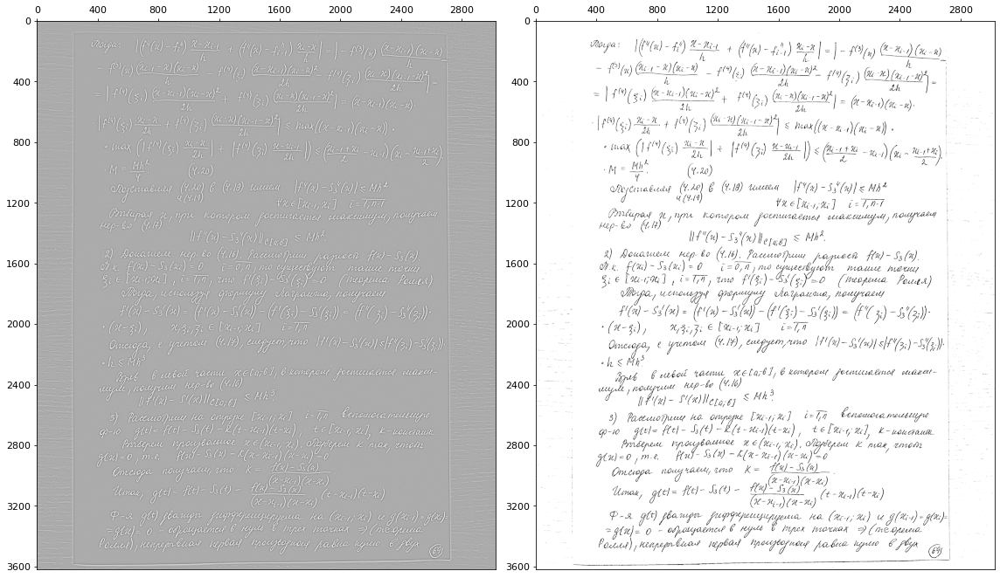

In [23]:
img = to_1ch(img_src, 'gray')
# img = gaussian(img, sigma=1.0)
# img = gaussian(unsharp_mask(gaussian(img, sigma=1.0), radius=25, amount=3), sigma=1.0)

img = img / (gaussian(img, sigma=5) + 0.001)
# img = equalize_hist(img)
# img = gaussian(unsharp_mask(gaussian(img, sigma=1.0), radius=25, amount=3), sigma=1.0)

# # img_hue = to_1ch(img, 'h')

res = invert(to_bin(img))

show_images([img, res], factor_r = 10, factor_c = 8) 

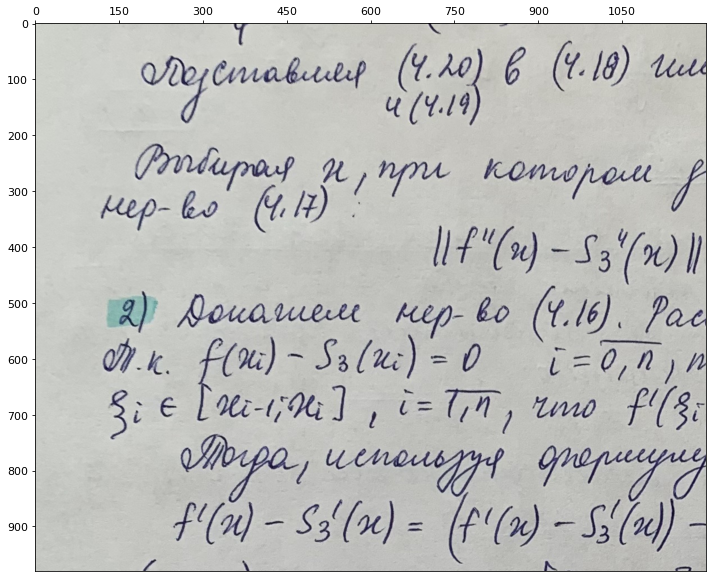

In [24]:
show_images([img_src[1020:2000, 300:1500]], factor_r = 10, factor_c = 10)

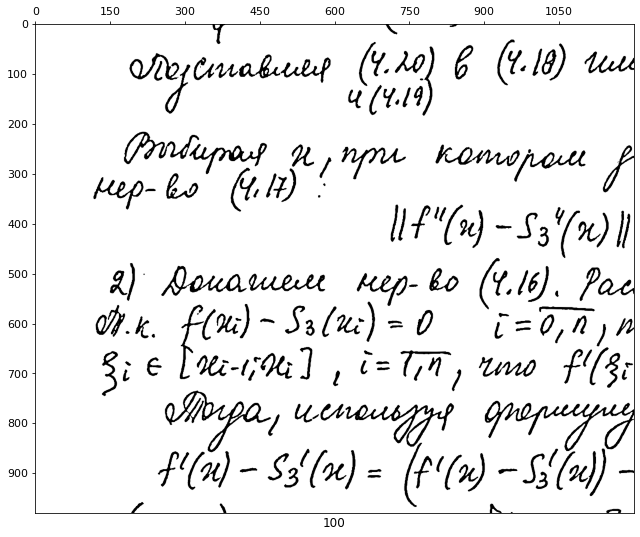

In [25]:
img_ = to_1ch(img_src[1020:2000, 300:1500])

for g_ in [100]:#, 10, 20, 30, 40, 50]:
    img = img_
    img = img // (gaussian(img, sigma=g_) + 0.001)
#     img = unsharp_mask(gaussian(img, sigma=0.0001), radius=30, amount=3)
    img = invert(to_bin(img))
#     show_images([img], [g_], factor_r = 10, factor_c = 10)
    
    img = unsharp_mask(gaussian(img, sigma=0.8), radius=7, amount=10)
    show_images([img], [g_], factor_r = 10, factor_c = 9)

In [26]:
def get_full_text_mask(img):
    img = to_1ch(img)
    img = img // (gaussian(img, sigma=50) + 0.001)
    img = invert(to_bin(img))
    img = unsharp_mask(gaussian(img, sigma=0.8), radius=7, amount=10)
    return img > 0

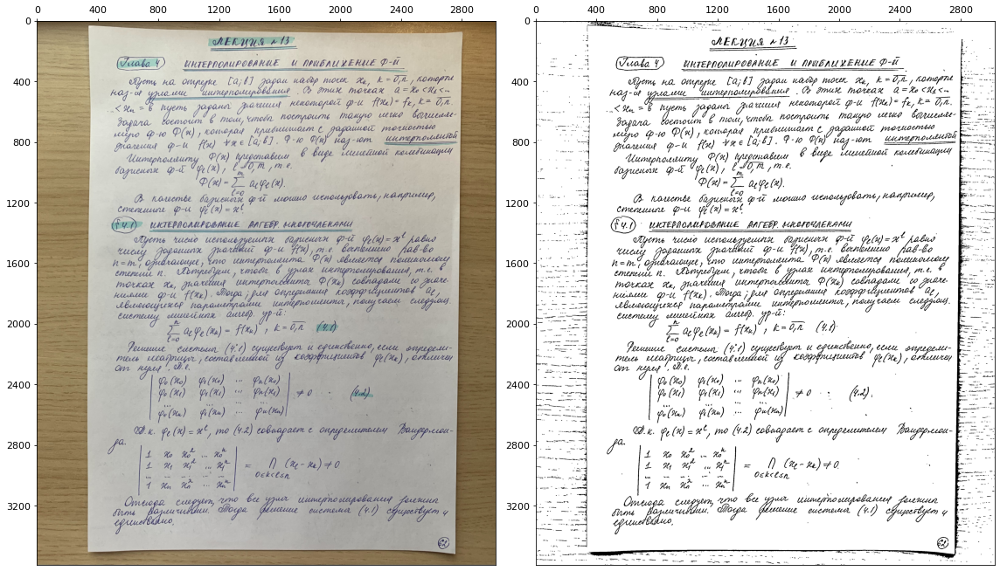

In [27]:
img = src_images[0]
res = get_full_text_mask(img)

show_images([img, res], factor_r = 10, factor_c = 8) 

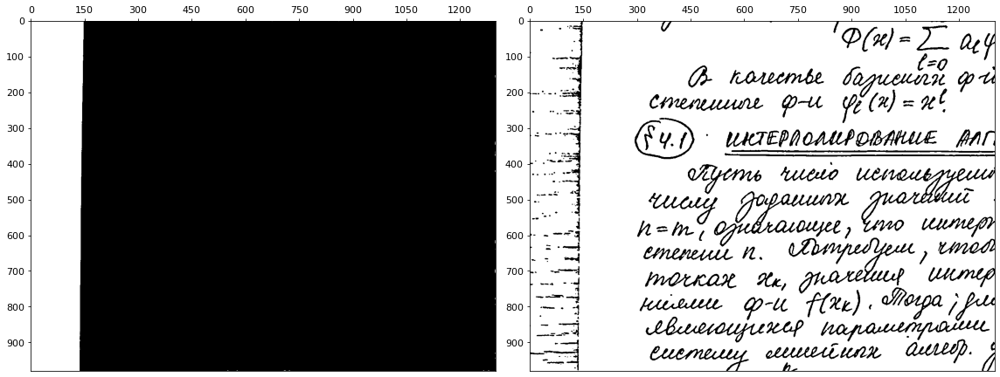

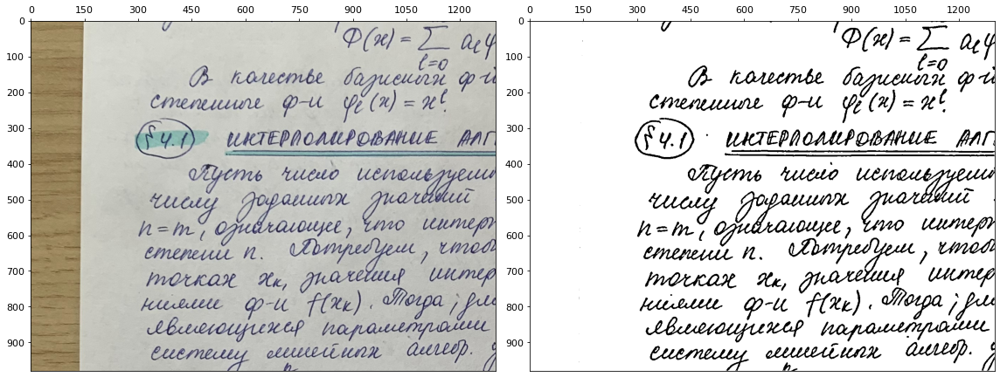

In [28]:
img = src_images[0][1020:2000, 200:1500]
paper_mask = get_paper_mask(img)
text_mask = get_full_text_mask(img)
res = paper_mask * text_mask

show_images([paper_mask, text_mask], factor_r = 10, factor_c = 8)
show_images([img, res], factor_r = 10, factor_c = 8) 

In [29]:
def get_text_mask(img, border=0):
    paper_mask = get_paper_mask(img, border)
    text_mask = get_full_text_mask(img)
    res = paper_mask * text_mask
    return res > 0

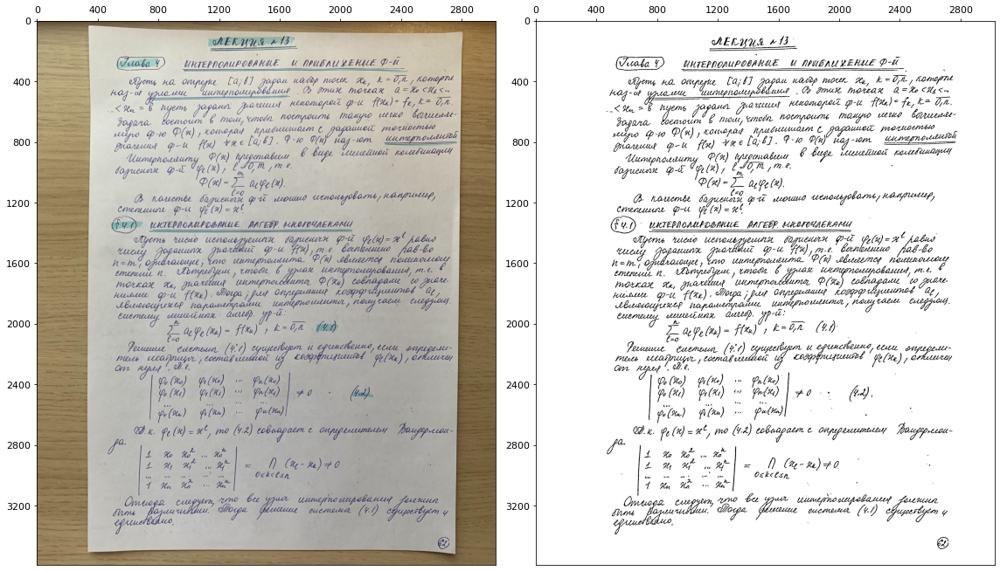

In [30]:
img = src_images[0] #[1020:2000, 300:1500]
res = get_text_mask(img, 10)

show_images([img, res], factor_r = 10, factor_c = 8) 

### Experiment 3: coloring paper and text

In [31]:
def get_paper_and_text(img):
    # paper
    paper = np.copy(img)
    paper = to_1ch(paper, mode='s')
    paper = invert(to_bin(paper))
    
    pad_val = 30
    border = 10
    
    paper = set_padding(paper, pad_val, False)
    paper = binary_fill_holes(paper, disk(1))
    paper = binary_closing(paper, disk(10))

    paper = remove_small_objects(paper, 10000)
    paper = set_padding(paper, -pad_val, False) > 0
    
    # paper2 for text
    paper2 = np.copy(paper)
    paper2 = erosion(paper2, disk(border)) > 0
    
    # text
    text = np.copy(img)
    text = to_1ch(text)
    text = text // (gaussian(text, sigma=50) + 0.001)
    text = invert(to_bin(text))
    text = unsharp_mask(gaussian(text, sigma=0.8), radius=7, amount=10) > 0
    text = text * paper2

    return paper, text

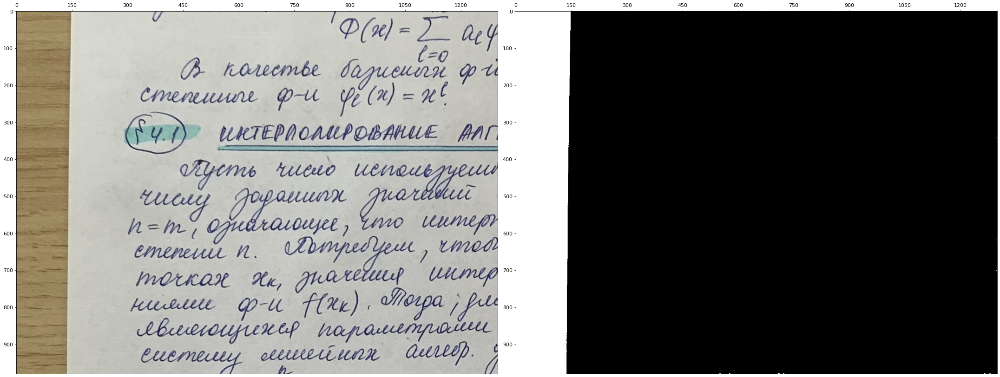

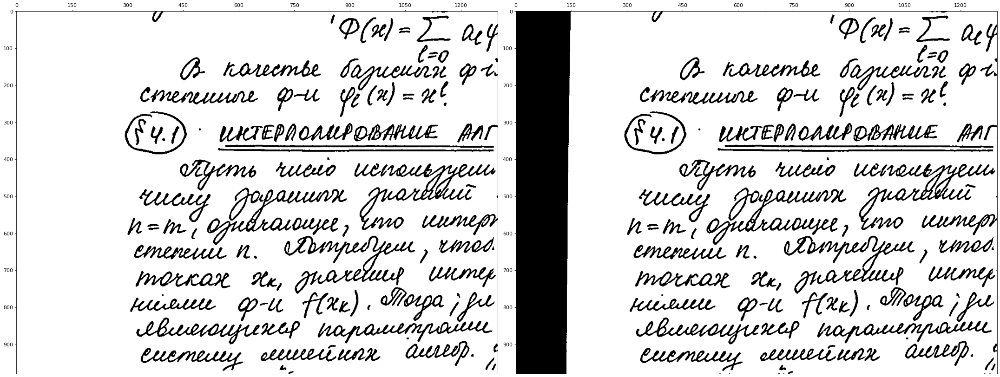

In [32]:
img = src_images[0][1020:2000, 200:1500]
paper_mask, text_mask = get_paper_and_text(img)
bg_paper_mask = invert(text_mask) * paper_mask

show_images([img, paper_mask], factor_r = 15, factor_c = 15)
show_images([text_mask, invert(bg_paper_mask)], factor_r = 15, factor_c = 15)

In [33]:
def color_mask(img, mask, color):
    img = np.copy(img)
    img[mask] = color
    return img

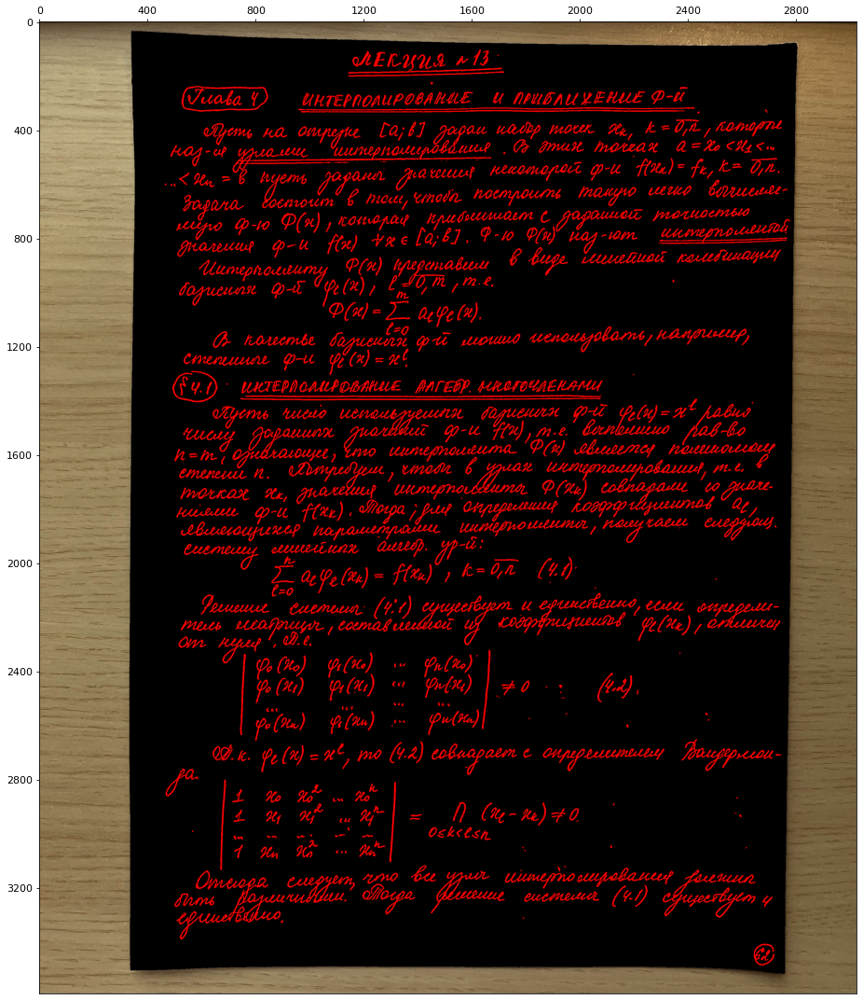

In [34]:
img, name = src_images[0], src_names_arr[0]

paper_mask, text_mask = get_paper_and_text(img)
bg_paper_mask = invert(text_mask) * paper_mask

img = color_mask(img, text_mask, [255, 0, 0])
img = color_mask(img, bg_paper_mask, [0, 0, 0])

show_images([img], factor_r = 15, factor_c = 15)

In [35]:
Image.fromarray(img).save(f'{output_folder}/res_{name}')

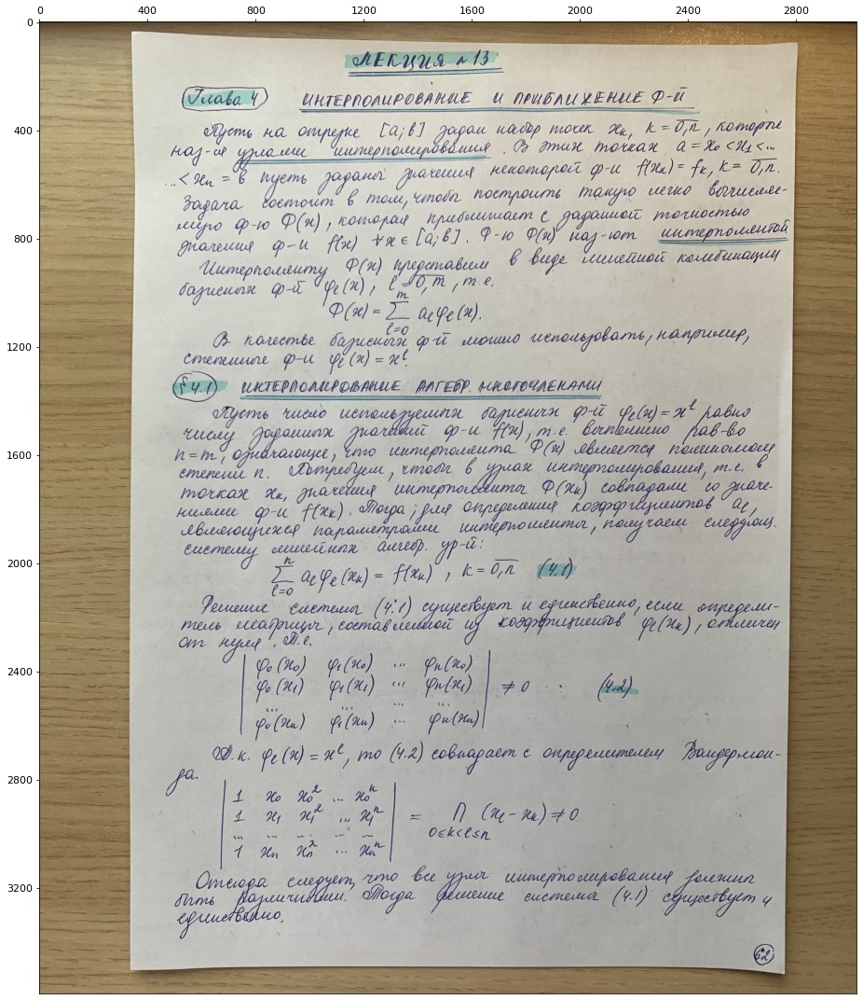

In [36]:
show_images([src_images[0]], factor_r = 15, factor_c = 15)

### Experiment 4: projecting text

In [37]:
img, name = src_images[0], src_names_arr[0]

paper_mask, text_mask = get_paper_and_text(img)
bg_paper_mask = invert(text_mask) * paper_mask

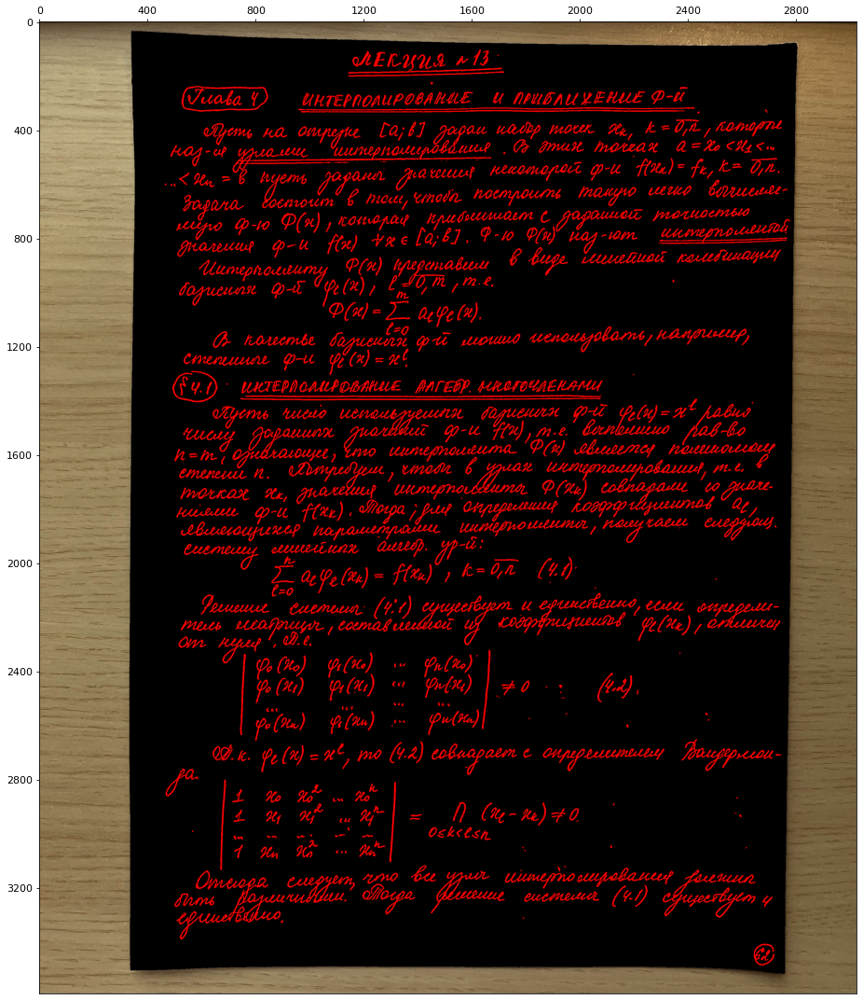

In [38]:
img = color_mask(img, text_mask, [255, 0, 0])
img = color_mask(img, bg_paper_mask, [0, 0, 0])

show_images([img], factor_r = 15, factor_c = 15)

#### Finding corners and middles:

In [39]:
img = np.copy(to_bin_uint8(paper_mask))
contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contour = contours[0]

main_img = np.copy(src_images[0])
cv2.drawContours(main_img, contours, 0, (255, 0, 0), 10)
show_image_cv(main_img, f'')

img = np.copy(to_bin_uint8(paper_mask))
eps_ = 0.083 # [0.002, 0.164]; mean = 0.083
epsilon= eps_ * cv2.arcLength(contour, True)
borders = cv2.approxPolyDP(contour, epsilon, True)
n = len(borders)

if n != 4:
    delta = 0.001
    if n < 4:
        delta = -delta
    n_old = n

while n != 4:
    print(n)
    eps_ += delta
    epsilon= eps_ * cv2.arcLength(contour, True)
    borders = cv2.approxPolyDP(contour, epsilon, True)
    n = len(borders)
    if n_old < 4 and n > 4 or n_old > 4 and n < 4:
        delta = -delta / 10    
    n_old = n

main_img = np.copy(src_images[0])
cv2.drawContours(main_img, [borders], 0, (255, 0, 0), 10)
show_image_cv(main_img, f'')

In [40]:
def get_middle_coords(coords):
    n = len(coords)
    return np.array([np.mean([corners[i], corners[(i + 1) % 4]], axis=0)
                       .astype(np.int) for i in range(n)])

def get_paper_coords(paper_mask):
    img = to_bin_uint8(paper_mask)
    
    # contour
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contour = contours[0]
    
    # corners
    eps_ = 0.083 # it's mean of [0.002, 0.164]
    epsilon= eps_ * cv2.arcLength(contour, True)
    borders = cv2.approxPolyDP(contour, epsilon, True)
    n = len(borders)

    # epsilon search if not rectangle
    if n != 4:
        delta = 0.001
        if n < 4:
            delta = -delta
        n_old = n

        while n != 4:
            eps_ += delta
            epsilon= eps_ * cv2.arcLength(contour, True)
            borders = cv2.approxPolyDP(contour, epsilon, True)
            n = len(borders)

            if n_old < 4 and n > 4 or n_old > 4 and n < 4:
                delta = -delta / 10    
            n_old = n
            
    corners = borders.reshape((4, 2))
    
    # middles
    middles = []
    contour = contour.reshape(-1, 2)
    for i in range(4):
        c1, c2 = corners[i], corners[(i + 1) % 4]

        side = 0
        if np.abs(c1[0] - c2[0]) < np.abs(c1[1] - c2[1]):
            side = 1

        i1 = np.where((contour[:,0] == c1[0]) & (contour[:,1] == c1[1]))[0][0]
        i2 = np.where((contour[:,0] == c2[0]) & (contour[:,1] == c2[1]))[0][0]
        if i1 < i2:
            contour_border = contour[i1: i2 + 1]
        else:
            contour_border = np.vstack([contour[i1:], contour[:i2]])

        contour_border = np.array(sorted(contour_border, key = lambda x: x[side]))
        
        contour_border_side = contour_border[:, side]
        
        mid_side = np.mean([c1, c2], axis=0).astype(np.int)[side]
               
        mid_mask = (np.array(([True] + list(contour_border_side <= mid_side)))[:-1] *
                    (contour_border_side >= mid_side) +
                    np.array((list(contour_border_side >= mid_side) + [True]))[1:] *
                    (contour_border_side <= mid_side))
        
        points = contour_border[mid_mask]
        if len(points) == 3:
            mid = points[1]
        else:
            mid = np.mean([points[0], points[1]], axis=0).astype(np.int)
        middles.append(mid)
    middles = np.array(middles)

    return corners, middles

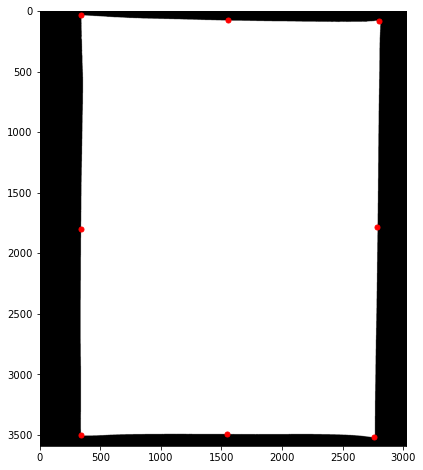

In [41]:
img = paper_mask

corners, middles = get_paper_coords(paper_mask)
points = []
for i in range(4):
    points += [corners[i], middles[i]]
points = np.array(points)

fig = plt.figure(figsize=(10, 8))
plt.imshow(img, cmap=plt.cm.gray)
plt.plot(points[:, 0], points[:, 1], '.r', markersize=10)
plt.show()

main_img = np.copy(src_images[0])
cv2.drawContours(main_img, [points], 0, (0, 0, 255), 10)
show_image_cv(main_img, f'Anchor points')

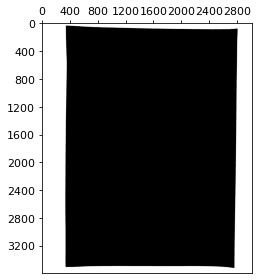

In [42]:
show_images([paper_mask])

#### Bounding box:

In [43]:
def get_bb_coords(points):
    bb_min = np.array([np.min(points[:, 0]), np.min(points[:, 1])])
    bb_max = np.array([np.max(points[:, 0]), np.max(points[:, 1])])
    return np.array([bb_min, [bb_min[0], bb_max[1]], bb_max, [bb_max[0], bb_min[1]]])

In [44]:
corners

array([[ 341,   36],
       [ 337, 3503],
       [2757, 3518],
       [2802,   80]], dtype=int32)

In [45]:
points

array([[ 341,   36],
       [ 338, 1798],
       [ 337, 3503],
       [1547, 3492],
       [2757, 3518],
       [2781, 1783],
       [2802,   80],
       [1558,   78]])

In [46]:
bb = get_bb_coords(points)
bb

array([[ 337,   36],
       [ 337, 3518],
       [2802, 3518],
       [2802,   36]])

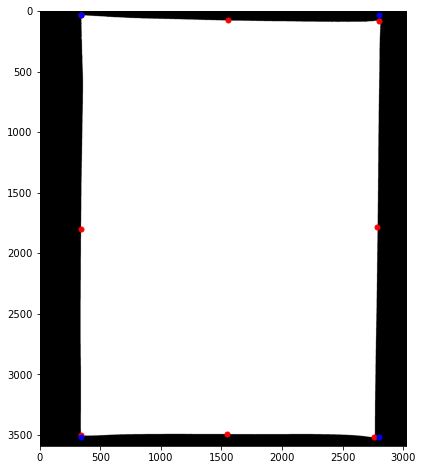

In [47]:
img = paper_mask

corners, middles = get_paper_coords(paper_mask)
points = []
for i in range(4):
    points += [corners[i], middles[i]]
points = np.array(points)

fig = plt.figure(figsize=(10, 8))
plt.imshow(img, cmap=plt.cm.gray)
plt.plot(points[:, 0], points[:, 1], '.r', markersize=10)
plt.plot(bb[:, 0], bb[:, 1], '.b', markersize=10)
plt.show()

In [48]:
bb

array([[ 337,   36],
       [ 337, 3518],
       [2802, 3518],
       [2802,   36]])

#### New points:

In [49]:
new_points = []
for i in range(4):
    p1, p2 = bb[i], bb[(i + 1) % 4]
    p_mid = np.mean([p1, p2], axis=0).astype(np.int)
    new_points += [p1, p_mid]
new_points = np.array(new_points)

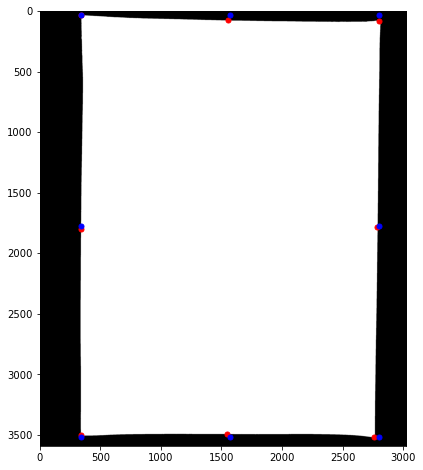

In [50]:
img = paper_mask

fig = plt.figure(figsize=(10, 8))
plt.imshow(img, cmap=plt.cm.gray)
plt.plot(points[:, 0], points[:, 1], '.r', markersize=10)
plt.plot(new_points[:, 0], new_points[:, 1], '.b', markersize=10)
plt.show()

In [51]:
main_img = np.copy(src_images[0])
cv2.drawContours(main_img, [bb], 0, (0, 0, 255), 10)
show_image_cv(main_img, f'Bounding box')

In [52]:
main_img = np.copy(src_images[0])
cv2.drawContours(main_img, [points], 0, (255, 0, 0), 10)
cv2.drawContours(main_img, [new_points], 0, (0, 255, 255), 10)
show_image_cv(main_img, f'Points vs new points')

In [53]:
new_points[:, 0] -= min(new_points[:, 0])
new_points[:, 1] -= min(new_points[:, 1])

In [54]:
new_points

array([[   0,    0],
       [   0, 1741],
       [   0, 3482],
       [1232, 3482],
       [2465, 3482],
       [2465, 1741],
       [2465,    0],
       [1232,    0]])

In [55]:
new_points_shape = (max(new_points[:, 0]), max(new_points[:, 1]))[::-1]
new_points_shape

(3482, 2465)

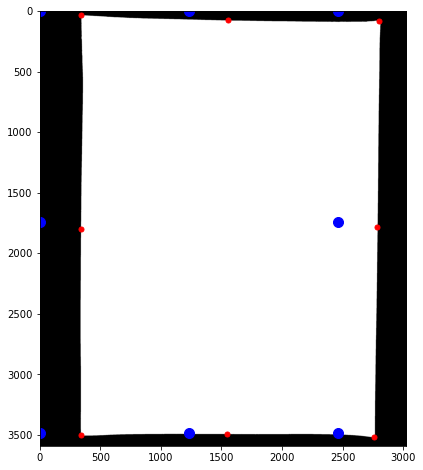

In [56]:
img = paper_mask

fig = plt.figure(figsize=(10, 8))
plt.imshow(img, cmap=plt.cm.gray)
plt.plot(points[:, 0], points[:, 1], '.r', markersize=10)
plt.plot(new_points[:, 0], new_points[:, 1], '.b', markersize=20)
plt.show()

#### Projection:

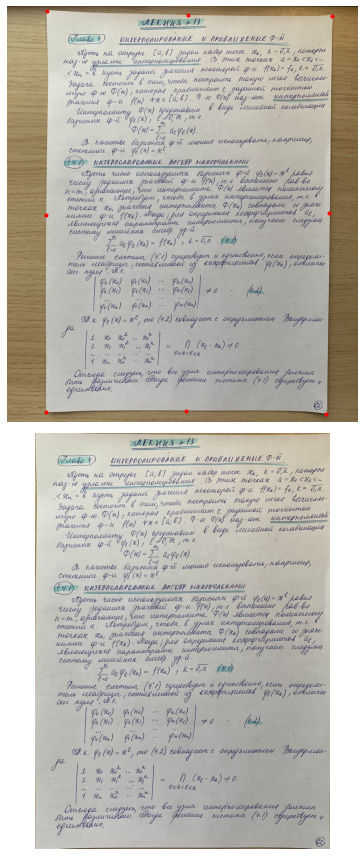

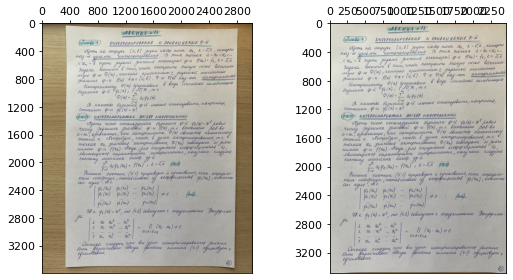

In [57]:
main_img = np.copy(src_images[0])

src = new_points #np.array([[0, 0], [0, 50], [300, 50], [300, 0]])
dst = points #np.array([[155, 15], [65, 40], [260, 130], [360, 95]])

tform3 = transform.ProjectiveTransform()
tform3.estimate(src, dst)
warped = transform.warp(main_img, tform3, output_shape=new_points_shape)

fig, ax = plt.subplots(nrows=2, figsize=(12, 12))
ax[0].imshow(main_img, cmap=plt.cm.gray)
ax[0].plot(dst[:, 0], dst[:, 1], '.r')
ax[1].imshow(warped, cmap=plt.cm.gray)

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

show_images([main_img, warped])

### Experiment 5: better projection

In [58]:
def get_paper_coords(paper_mask, iters=1):
    img = to_bin_uint8(paper_mask)
    
    # contour
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contour = contours[0]
    
    # corners
    eps_ = 0.083 # it's mean of [0.002, 0.164]
    epsilon= eps_ * cv2.arcLength(contour, True)
    borders = cv2.approxPolyDP(contour, epsilon, True)
    n = len(borders)

    # epsilon search if not rectangle
    if n != 4:
        delta = 0.001
        if n < 4:
            delta = -delta
        n_old = n

        while n != 4:
            eps_ += delta
            epsilon= eps_ * cv2.arcLength(contour, True)
            borders = cv2.approxPolyDP(contour, epsilon, True)
            n = len(borders)

            if n_old < 4 and n > 4 or n_old > 4 and n < 4:
                delta = -delta / 10    
            n_old = n
            
    corners, contour = borders.reshape((4, 2)), contour.reshape(-1, 2)
    res = []
    
    # loop by 4 borders
    for i in range(4):
        # border
        c1, c2 = corners[i], corners[(i + 1) % 4]
        side = 0
        if np.abs(c1[0] - c2[0]) < np.abs(c1[1] - c2[1]):
            side = 1
        i1 = np.where((contour[:,0] == c1[0]) & (contour[:,1] == c1[1]))[0][0]
        i2 = np.where((contour[:,0] == c2[0]) & (contour[:,1] == c2[1]))[0][0]
        if i1 < i2:
            contour_border = contour[i1: i2 + 1]
        else:
            contour_border = np.vstack([contour[i1:], contour[:i2]])
        contour_border = np.array(sorted(contour_border, key = lambda x: x[side]))
        contour_border_side = contour_border[:, side]
        
        # iterations on border
        
        arr = [c1, c2]
        for j in range(iters):
            arr_len = len(arr)
            new_arr = []
            for k in range(arr_len - 1):
                p1, p2 = arr[k], arr[k + 1]
                mid_side = np.mean([p1, p2], axis=0).astype(np.int)[side]

                mid_mask = (np.array(([True] + list(contour_border_side <= mid_side)))[:-1] *
                            (contour_border_side >= mid_side) +
                            np.array((list(contour_border_side >= mid_side) + [True]))[1:] *
                            (contour_border_side <= mid_side))

                points = contour_border[mid_mask]
                if len(points) == 3:
                    mid = points[1]
                elif len(points) == 2:
                    mid = np.array([0, 0])
                    mid[side] = mid_side
                    mid[1 - side] = np.mean([points[0], points[1]], axis=0).astype(np.int)[1 - side]
                elif len(points) == 1:
                    mid = points[0]
                else:
                    print(points)
                    assert 1 == 0
                new_arr += [p1, mid]
            new_arr += [arr[-1]]
            arr = new_arr
        res += arr[:-1]
    res = np.array(res)

    bb = get_bb_coords(res)
    res2 = []
    
    for i in range(4):
        # border
        arr = [bb[i], bb[(i + 1) % 4]]
        for j in range(iters):
            arr_len = len(arr)
            new_arr = []
            for k in range(arr_len - 1):
                p1, p2 = arr[k], arr[k + 1]
                mid = np.mean([p1, p2], axis=0).astype(np.int)
                new_arr += [p1, mid]
            new_arr += [arr[-1]]
            arr = new_arr
        res2 += arr[:-1]
    res2 = np.array(res2)
    
    return res, res2

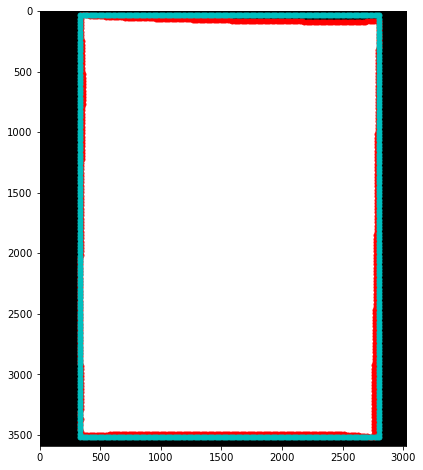

In [59]:
img = paper_mask

points, points2 = get_paper_coords(paper_mask, 7)

fig = plt.figure(figsize=(10, 8))
plt.imshow(img, cmap=plt.cm.gray)
plt.plot(points[:, 0], points[:, 1], '.r', markersize=10)
plt.plot(points2[:, 0], points2[:, 1], '.c', markersize=10)

plt.show()

main_img = np.copy(src_images[0])
cv2.drawContours(main_img, [points], 0, (0, 0, 255), 10)
cv2.drawContours(main_img, [points2], 0, (255, 255, 0), 10)
show_image_cv(main_img, f'Anchor points')

In [60]:
points3 = np.copy(points2)
points3[:, 0] -= min(points3[:, 0])
points3[:, 1] -= min(points3[:, 1])

In [61]:
points3_shape = (max(points3[:, 0]), max(points3[:, 1]))[::-1]
points3_shape

(3482, 2470)

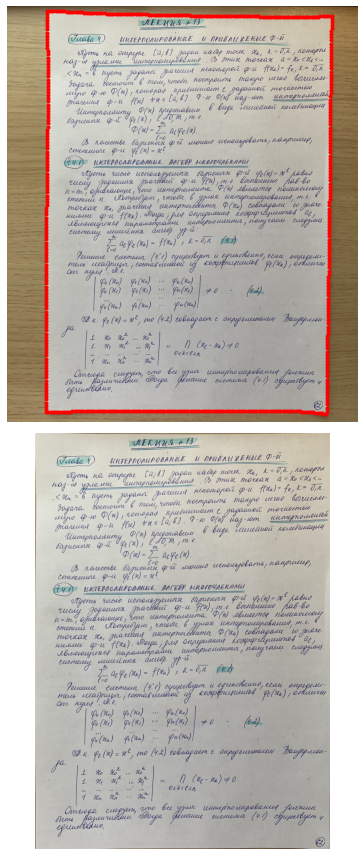

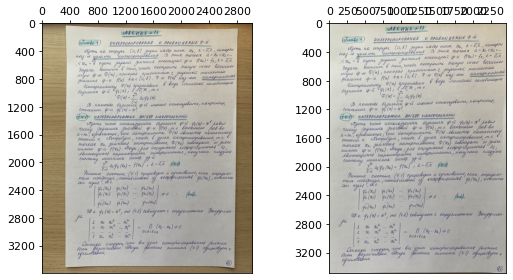

In [62]:
main_img = np.copy(src_images[0])

src = points3
dst = points

tform3 = transform.ProjectiveTransform()
tform3.estimate(src, dst)
warped = transform.warp(main_img, tform3, output_shape=points3_shape)

fig, ax = plt.subplots(nrows=2, figsize=(12, 12))
ax[0].imshow(main_img, cmap=plt.cm.gray)
ax[0].plot(dst[:, 0], dst[:, 1], '.r')
ax[1].imshow(warped, cmap=plt.cm.gray)

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

show_images([main_img, warped])

#### To functions:

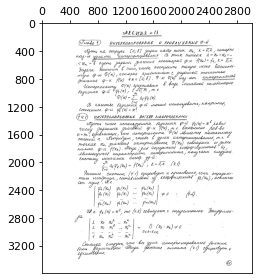

In [63]:
show_images([text_mask])

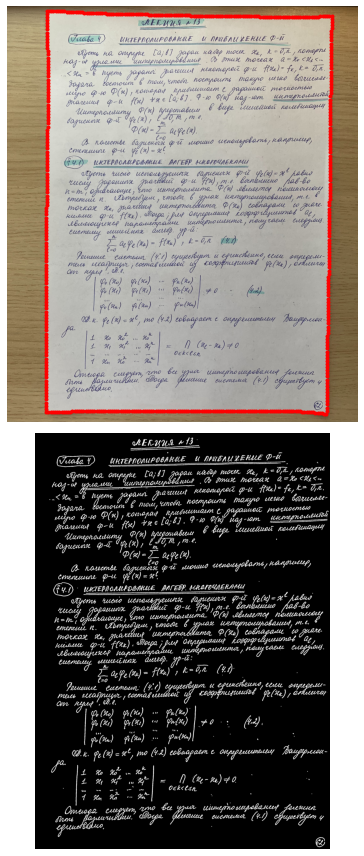

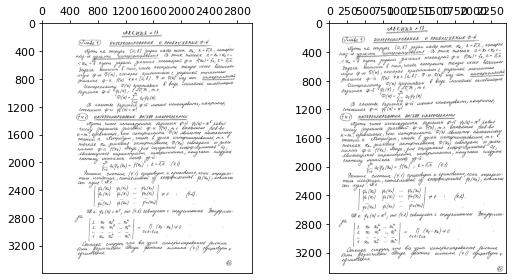

In [64]:
img = np.copy(text_mask)

src = points3
dst = points

tform3 = transform.ProjectiveTransform()
tform3.estimate(src, dst)
warped = transform.warp(img, tform3, output_shape=points3_shape)

fig, ax = plt.subplots(nrows=2, figsize=(12, 12))
ax[0].imshow(main_img, cmap=plt.cm.gray)
ax[0].plot(dst[:, 0], dst[:, 1], '.r')
ax[1].imshow(warped, cmap=plt.cm.gray)

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

show_images([img, warped])

In [65]:
def get_projected_paper(img, in_points, out_points, vis=False):
    out_points = np.copy(out_points)
    out_points[:, 0] -= min(out_points[:, 0])
    out_points[:, 1] -= min(out_points[:, 1])
    out_shape = (max(out_points[:, 0]), max(out_points[:, 1]))[::-1]

    tform3 = transform.ProjectiveTransform()
    tform3.estimate(out_points, in_points)
    res = transform.warp(img, tform3, output_shape=out_shape)

    if vis:
        fig, ax = plt.subplots(nrows=2, figsize=(12, 12))
        ax[0].imshow(main_img, cmap=plt.cm.gray)
        ax[0].plot(in_points[:, 0], in_points[:, 1], '.r')
        ax[1].imshow(res, cmap=plt.cm.gray)

        for a in ax:
            a.axis('off')

        plt.tight_layout()
        plt.show()
        show_images([img, warped])
    return res

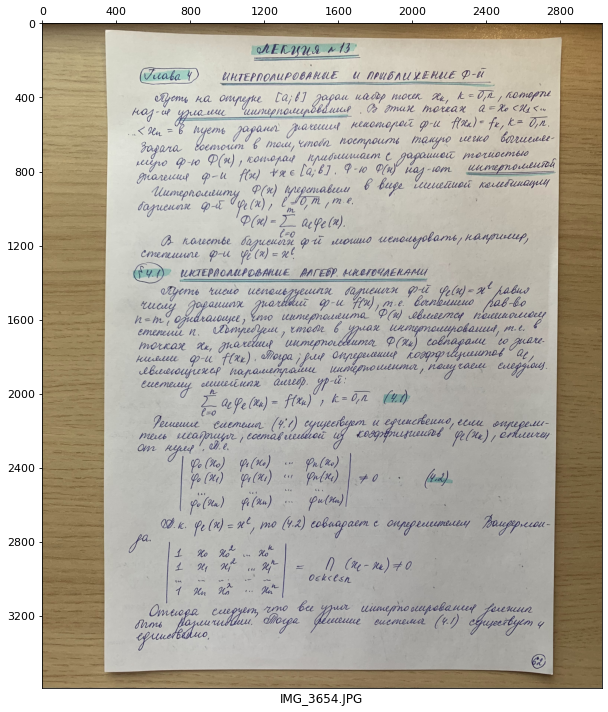

In [121]:
img, name = src_images[0], src_names_arr[0]
show_images([img], [name], factor_r = 10, factor_c = 10)

In [122]:
paper_mask, text_mask = get_paper_and_text(img)

In [127]:
in_points, out_points = get_paper_coords(paper_mask, 7)
img2 = get_projected_paper(img, in_points, out_points)

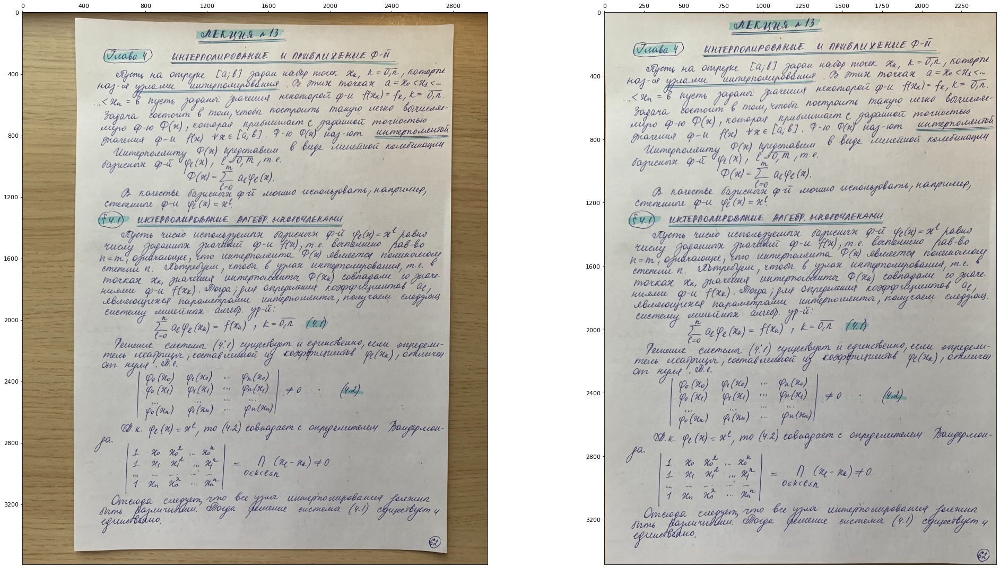

In [128]:
show_images([img, img2], factor_r = 15, factor_c = 15)

In [133]:
img2 = (img2 * 255).astype(np.uint8)

In [134]:
Image.fromarray(img).save(f'{output_folder}/src_1_{name}')
Image.fromarray(img2).save(f'{output_folder}/src_2_{name}')

In [135]:
paper_mask, text_mask = get_paper_and_text(img2)

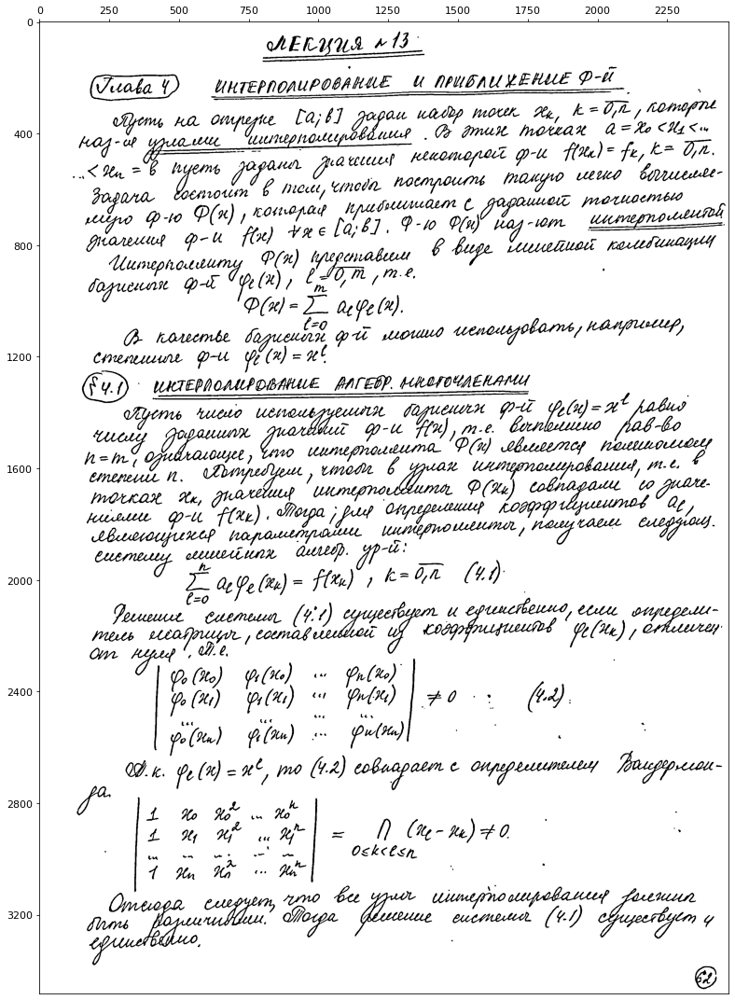

In [137]:
show_images([text_mask], factor_r = 15, factor_c = 15)

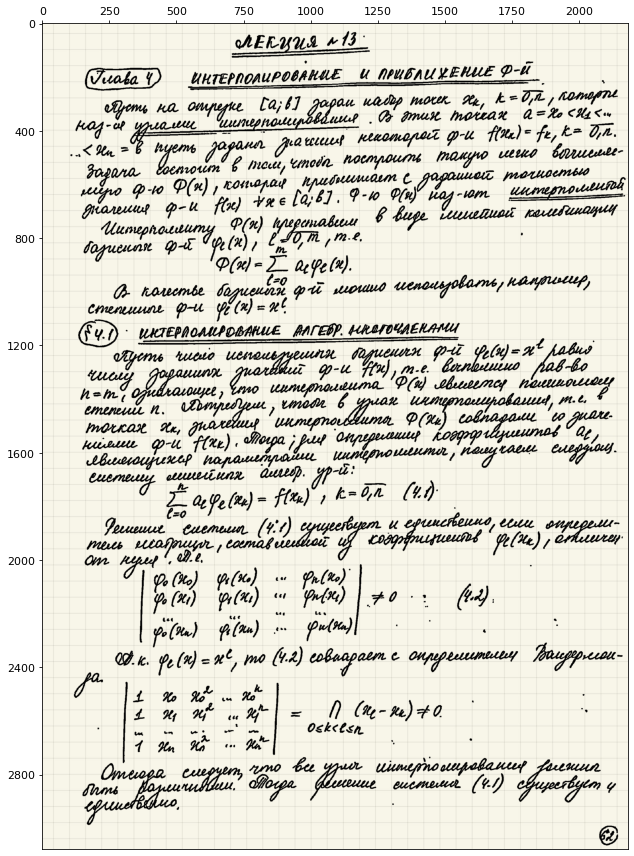

In [139]:
bg = bg_images[0]
text_mask2 = resize_contain(to_bin_uint8(text_mask), bg.shape[:2]) > 0
bg = crop_by_mask(bg, text_mask2)
img = color_mask(bg, text_mask2, [0, 0, 0])
show_images([img], factor_r = 12, factor_c = 12)

In [140]:
Image.fromarray(img).save(f'{output_folder}/res_333_{name}')

#### Result:

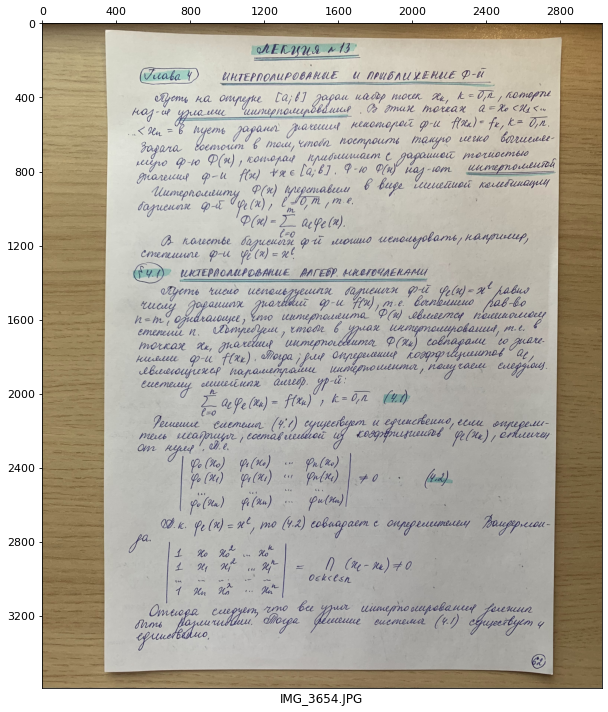

In [66]:
img, name = src_images[0], src_names_arr[0]
show_images([img], [name], factor_r = 10, factor_c = 10)

In [67]:
paper_mask, text_mask = get_paper_and_text(img)
bg_paper_mask = invert(text_mask) * paper_mask

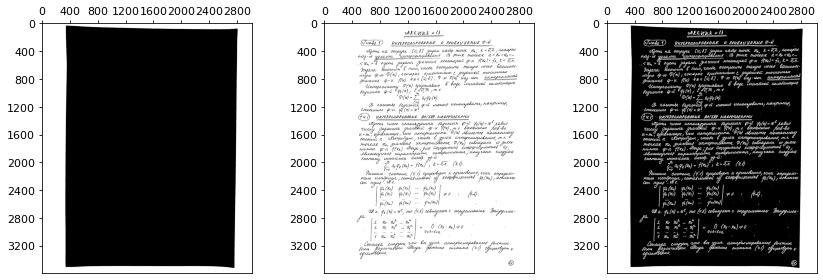

In [68]:
show_images([paper_mask, text_mask, bg_paper_mask])

In [69]:
# img = color_mask(img, text_mask, [255, 0, 0])
# img = color_mask(img, bg_paper_mask, [0, 0, 0])
# show_images([img], factor_r = 15, factor_c = 15)

In [119]:
in_points, out_points = get_paper_coords(paper_mask, 1)
text_mask2 = get_projected_paper(text_mask, in_points, out_points) > 0

In [120]:
Image.fromarray(text_mask2).save(f'{output_folder}/text_mask2_1_{name}')

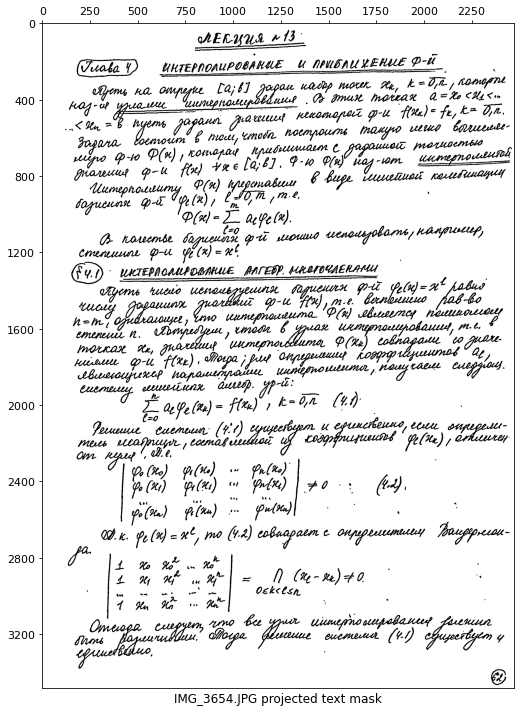

In [71]:
show_images([text_mask2], [f'{name} projected text mask'], factor_r = 10, factor_c = 10)

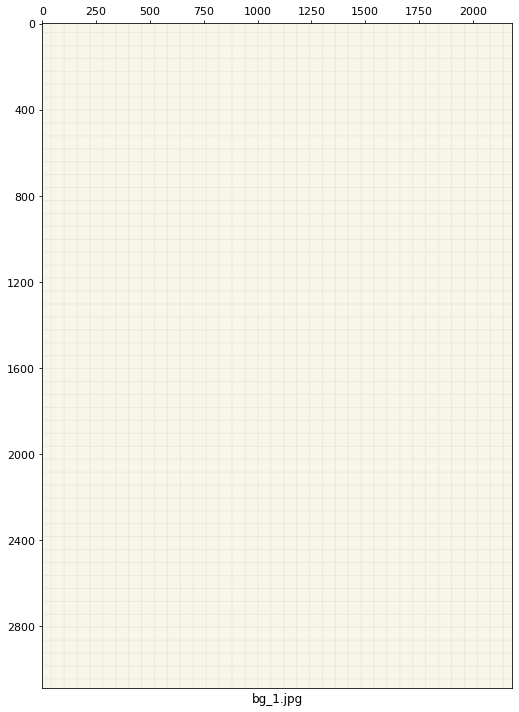

In [72]:
bg = bg_images[0]
show_images([bg], [bg_names[0]], factor_r = 10, factor_c = 10)

In [94]:
def resize_contain(img, shape):
    h1, w1 = img.shape[:2]
    h2, w2 = shape[:2]
    
    if h2 < h1 and w2 < w1:
        ratio = h1 / h2
        h, w = h2, int(w1 / ratio)
        if w > w2:
            ratio = w1 / w2
            h, w = int(h1 / ratio), w2
    elif h2 < h1 and w2 >= w1:
        print('d')
        ratio = h1 / h2
        h, w = h2, int(w1 / ratio)
    elif h2 >= h1 and w2 < w1:
        print('dd')
        ratio = w1 / w2
        h, w = int(h1 / ratio), w2
    else:
        return img
    return cv2.resize(img, (w, h), interpolation=cv2.INTER_AREA)

In [107]:
def crop_by_mask(img, mask):
    s1 = img.shape[:2]
    s2 = mask.shape[:2]
    if s1[0] > s2[0]:
        d = s1[0] - s2[0]
        top_, bottom_ = d // 2 + d % 2, d // 2
        img = img[top_:-bottom_,:,:]
    if s1[1] > s2[1]:
        d = s1[1] - s2[1]
        left_, right_ = d // 2 + d % 2, d // 2
        img = img[:,left_:-right_,:]
    return img

In [106]:
text_mask2 = resize_contain(to_bin_uint8(text_mask2), bg.shape[:2]) > 0
bg = crop_by_mask(bg, text_mask2)

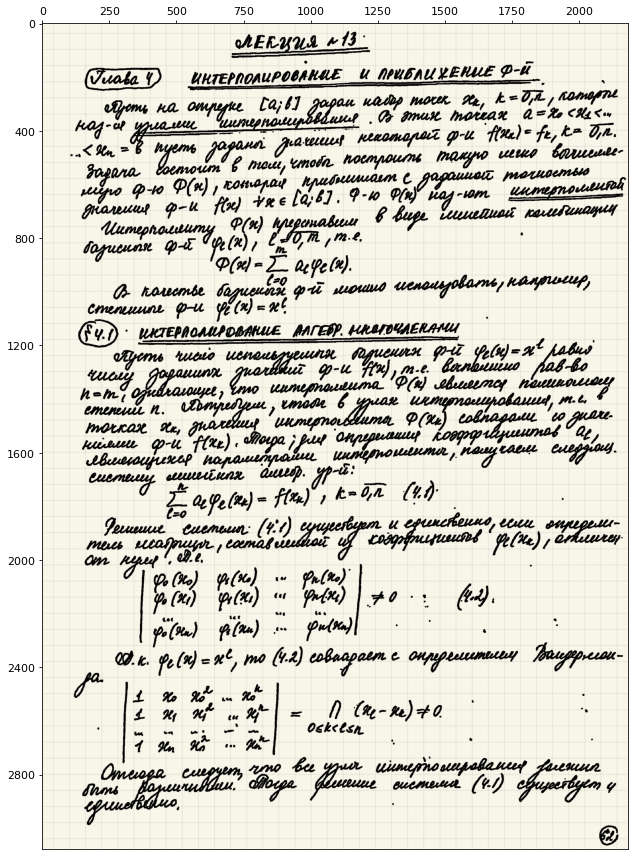

In [113]:
img = color_mask(bg, text_mask2_resized, [0, 0, 0])
show_images([img], factor_r = 12, factor_c = 12)

In [116]:
Image.fromarray(img).save(f'{output_folder}/res_2_{name}')

In [354]:
text_mask

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])